In [147]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from gaussian_pyr import gaussian_pyr
from dog_pyr import dog_pyr
from keypoints import keypoints
from img_gradient import img_gradient
from orientations import orientations
from descriptors import descriptors

# Example1: Applying SIFT algorithm on Indian Currency Notes 

In [148]:
img1 = cv2.imread('./100note.png', cv2.IMREAD_GRAYSCALE)  
img2 = cv2.imread('./note_pile.png', cv2.IMREAD_GRAYSCALE)  

img1 = img1 / 255.0
img2 = img2 / 255.0

In [149]:
img1.shape

(602, 1112)

In [150]:
gaussian_pyr1 = gaussian_pyr(img1)
gaussian_pyr2 = gaussian_pyr(img2)

dog_pyr1 = dog_pyr(gaussian_pyr1)
dog_pyr2 = dog_pyr(gaussian_pyr2)

In [151]:
keypoints1 = keypoints(dog_pyr1, threshold=0.03)
keypoints2 = keypoints(dog_pyr2, threshold=0.03)

In [152]:
[len(keypoints1), len(keypoints2)]

[312, 284]

In [153]:
orientations1 = orientations(keypoints1, gaussian_pyr1)
orientations2 = orientations(keypoints2, gaussian_pyr2)

In [154]:
descriptors1 = descriptors(keypoints1, gaussian_pyr1)
descriptors2 = descriptors(keypoints2, gaussian_pyr2)

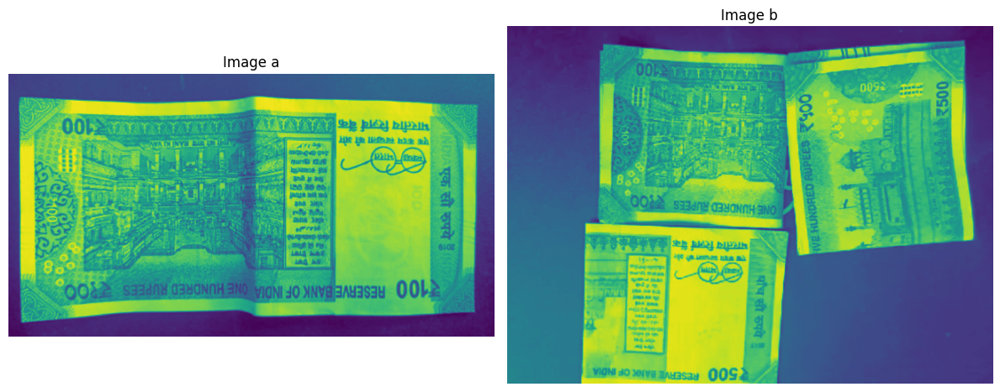

In [155]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.imshow(img1)
ax1.set_title('Image a')
ax1.axis('off')

ax2.imshow(img2)
ax2.set_title('Image b')
ax2.axis('off')
plt.tight_layout()
plt.show()

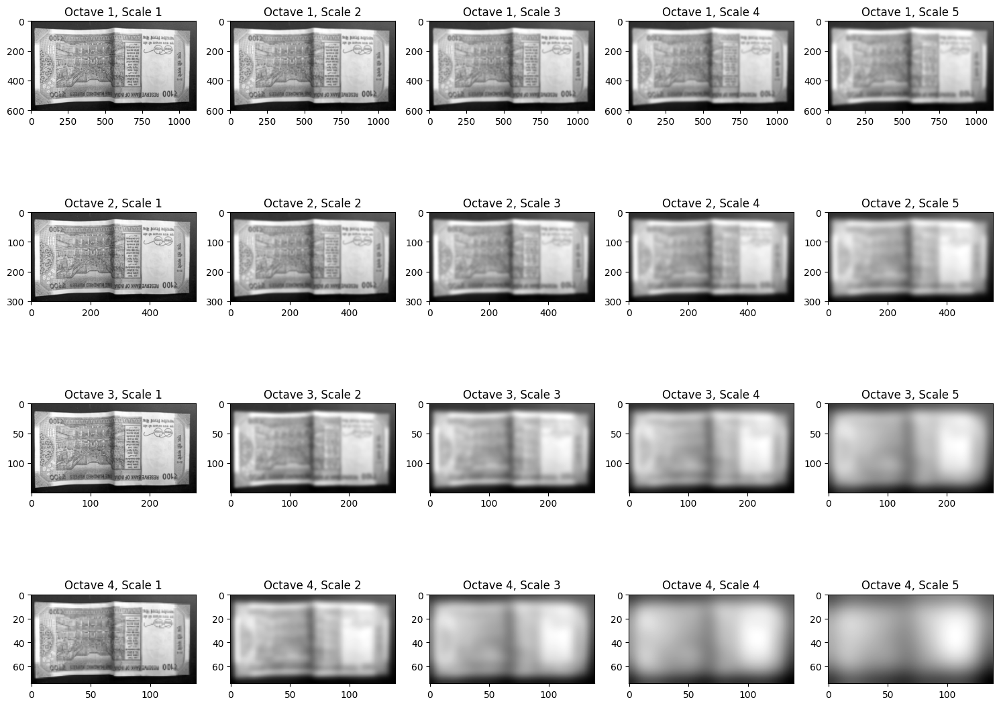

In [156]:
num_octaves1 = len(gaussian_pyr1)
num_scales1 = len(gaussian_pyr1[0])

fig, axes = plt.subplots(num_octaves1, num_scales1, figsize=(3*num_scales1, 3*num_octaves1))

for i in range(num_octaves1):
    for j in range(num_scales1):
        img = gaussian_pyr1[i][j]

        if num_octaves1 == 1:
            ax = axes[j]
        else:
            ax = axes[i, j]
        
        ax.imshow(img, cmap='gray')
        ax.set_title(f'Octave {i+1}, Scale {j+1}')
plt.tight_layout()
plt.show()

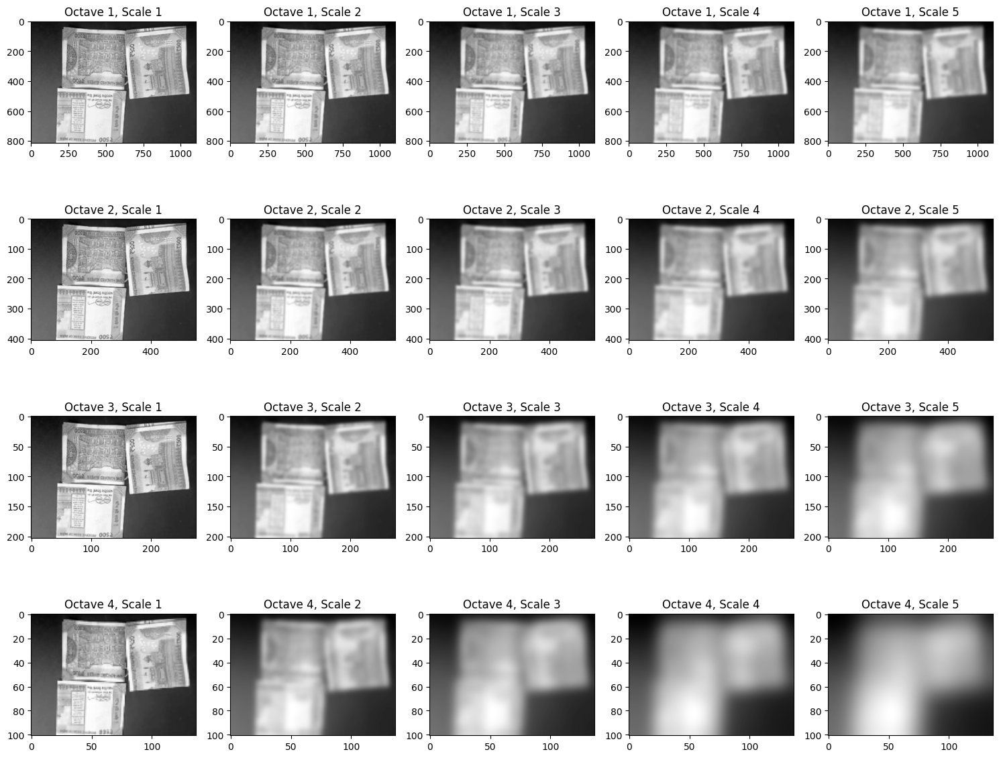

In [157]:
num_octaves2 = len(gaussian_pyr2)
num_scales2 = len(gaussian_pyr2[0])

fig, axes = plt.subplots(num_octaves2, num_scales2, figsize=(3*num_scales2, 3*num_octaves2))

for i in range(num_octaves2):
    for j in range(num_scales2):

        img = gaussian_pyr2[i][j]

        if num_octaves2 == 1:
            ax = axes[j]
        else:
            ax = axes[i, j]

        ax.imshow(img, cmap='gray')
        ax.set_title(f'Octave {i+1}, Scale {j+1}')

plt.tight_layout()
plt.show()

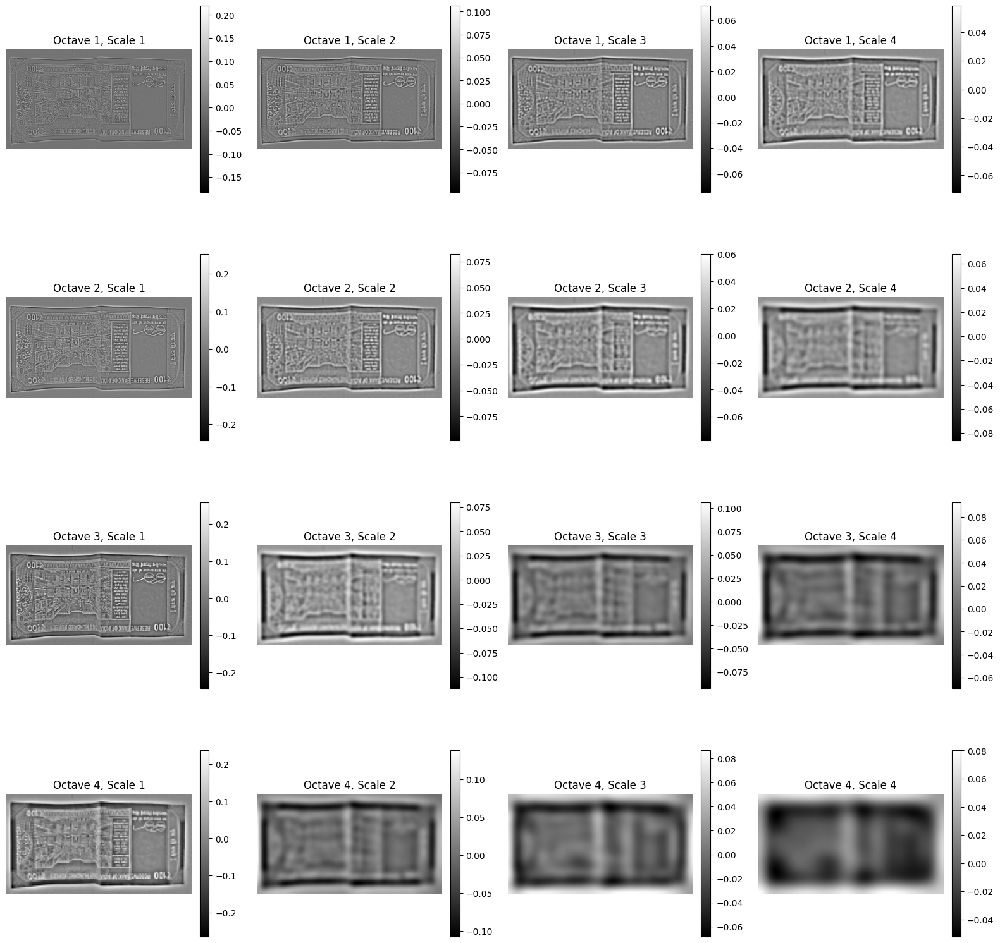

In [158]:
num_octaves1 = len(dog_pyr1)
num_scales1 = len(dog_pyr1[0])

fig, axes = plt.subplots(num_octaves1, num_scales1, figsize=(4*num_scales1, 4*num_octaves1))

for i, octave in enumerate(dog_pyr1):
    for j, dog_img in enumerate(octave):

        if num_octaves1 == 1:
            ax = axes[j]
        else:
            ax = axes[i, j]

        im = ax.imshow(dog_img, cmap='grey')
        ax.set_title(f'Octave {i+1}, Scale {j+1}')
        ax.axis('off')

        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

plt.tight_layout()
plt.show()

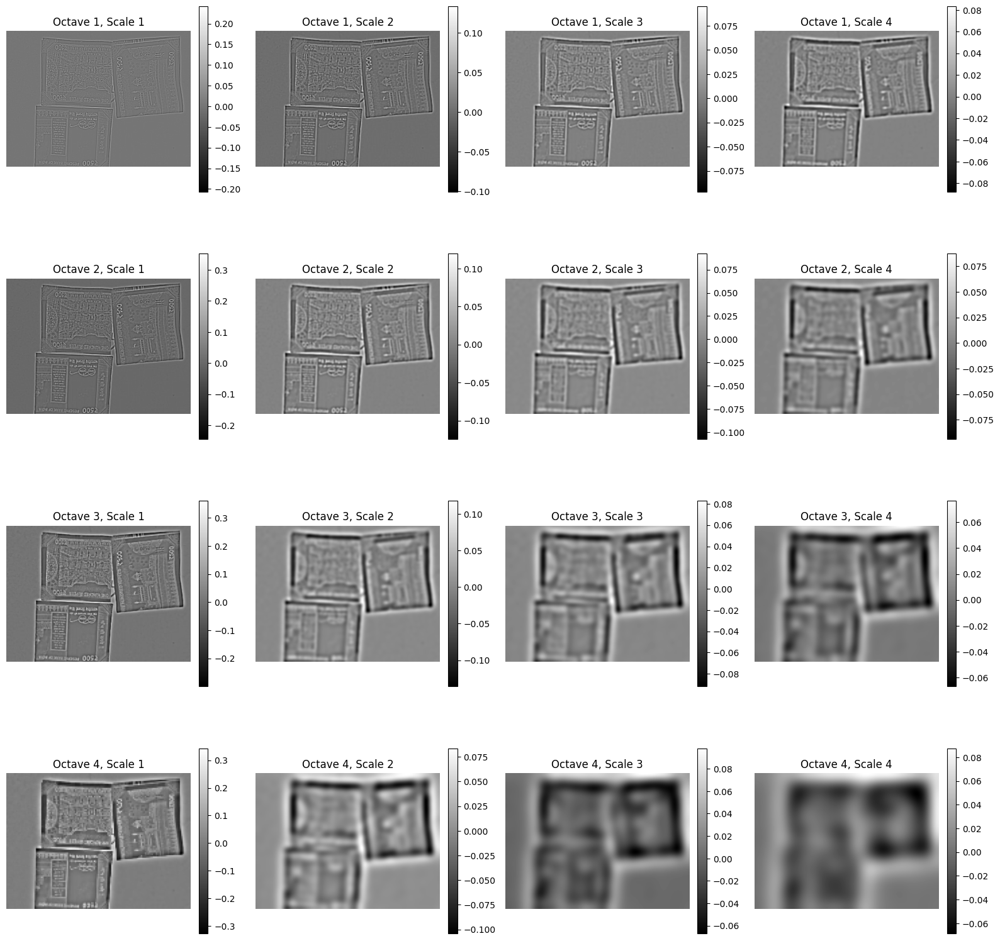

In [159]:
num_octaves2 = len(dog_pyr2)
num_scales2 = len(dog_pyr2[0])

fig, axes = plt.subplots(num_octaves2, num_scales2, figsize=(4*num_scales2, 4*num_octaves2))

for i, octave in enumerate(dog_pyr2):
    for j, dog_img in enumerate(octave):

        if num_octaves2 == 1:
            ax = axes[j]
        else:
            ax = axes[i, j]

        im = ax.imshow(dog_img, cmap='grey')
        ax.set_title(f'Octave {i+1}, Scale {j+1}')
        ax.axis('off')

        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

plt.tight_layout()
plt.show()

In [160]:
max_oct1 = keypoints1[-1][2]
max_oct2 = keypoints2[-1][2]

In [161]:
def visualize_keypoints(img, keypoints, title="Image with Keypoints"):
    h, w = img.shape
    fig, ax = plt.subplots(figsize=(15, 15))
    
    max_oct = max(kp[3] for kp in keypoints)
    
    ax.imshow(img, cmap='gray')
    hypotenuse = np.sqrt(h**2 + w**2)
    
    for (x, y, scale, octave) in keypoints:
        r = (hypotenuse * scale * (2**octave)) / (50 * (2**max_oct))
        circle = plt.Circle((y, x), r, color='white', fill=False, linewidth=2)
        ax.add_artist(circle)
    
    ax.set_title(title)
    ax.axis('off')
    plt.tight_layout()
    plt.show()

In [162]:
def visualize_octaves(gaussian_pyr, keypoints, num_octaves):
    fig, axs = plt.subplots(num_octaves, 2, figsize=(20, 20))
    max_oct = max(kp[3] for kp in keypoints)
    
    for i in range(num_octaves):
        img = gaussian_pyr[i][0]
        mag, ori = img_gradient(img)
        
        axs[i, 0].imshow(mag, cmap='gray')
        axs[i, 0].set_title(f'Octave {i} - Magnitude')
        
        axs[i, 1].imshow(ori, cmap='gray')
        axs[i, 1].set_title(f'Octave {i} - Orientation')
        
        h, w = mag.shape
        hypotenuse = np.sqrt(h**2 + w**2)
        
        for (x, y, scale, octave) in keypoints:
            if octave == i:
                r = (hypotenuse * scale * (2**octave)) / (50 * (2**max_oct))
                circle = plt.Circle((y, x), r, color='white', fill=False, linewidth=2)
                axs[i, 0].add_artist(circle)
    
    plt.tight_layout()
    plt.show()

In [163]:
def visualize_orientations(img, orientations, title="Keypoints with Orientations"):
    plt.figure(figsize=(10, 10))
    plt.imshow(img, cmap='gray')
    
    for (x, y, octave, orientation) in orientations:
        length = 50 * (2**octave)
        angle_rad = np.deg2rad(orientation)
        dx = length * np.cos(angle_rad)
        dy = length * np.sin(angle_rad)
        plt.arrow(y, x, dy, -dx, head_width=5, head_length=5, fc='red', ec='red')
    
    plt.title(title)
    plt.axis('off')
    plt.show()

In [164]:
def visualize_matches(img1, keypoints1, img2, keypoints2, descriptors1, descriptors2):
    img1 = (img1 * 255).astype(np.uint8)
    img2 = (img2 * 255).astype(np.uint8)
    
    descriptors1 = np.array(descriptors1, dtype=np.float32)
    descriptors2 = np.array(descriptors2, dtype=np.float32)
    
    bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
    matches = bf.match(descriptors1, descriptors2)
    
    img3 = cv2.drawMatches(
        img1, [cv2.KeyPoint(x[1], x[0], 1) for x in keypoints1],
        img2, [cv2.KeyPoint(x[1], x[0], 1) for x in keypoints2],
        matches[:50], None,
        matchColor=(255, 0, 0),
        singlePointColor=(255, 0, 0),
        flags=2
    )
    
    plt.figure(figsize=(20, 15))
    plt.imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

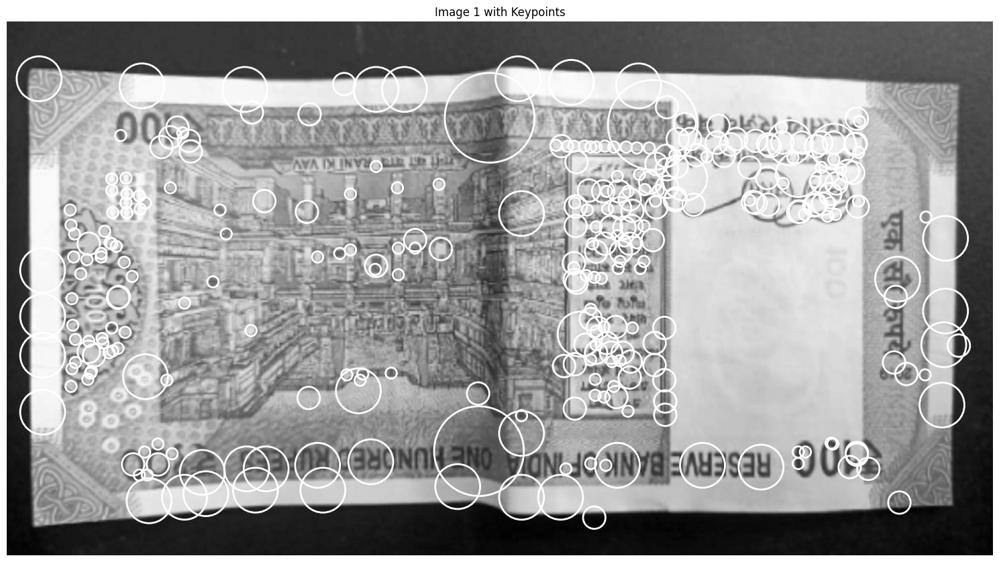

In [165]:
visualize_keypoints(img1, keypoints1, "Image 1 with Keypoints")

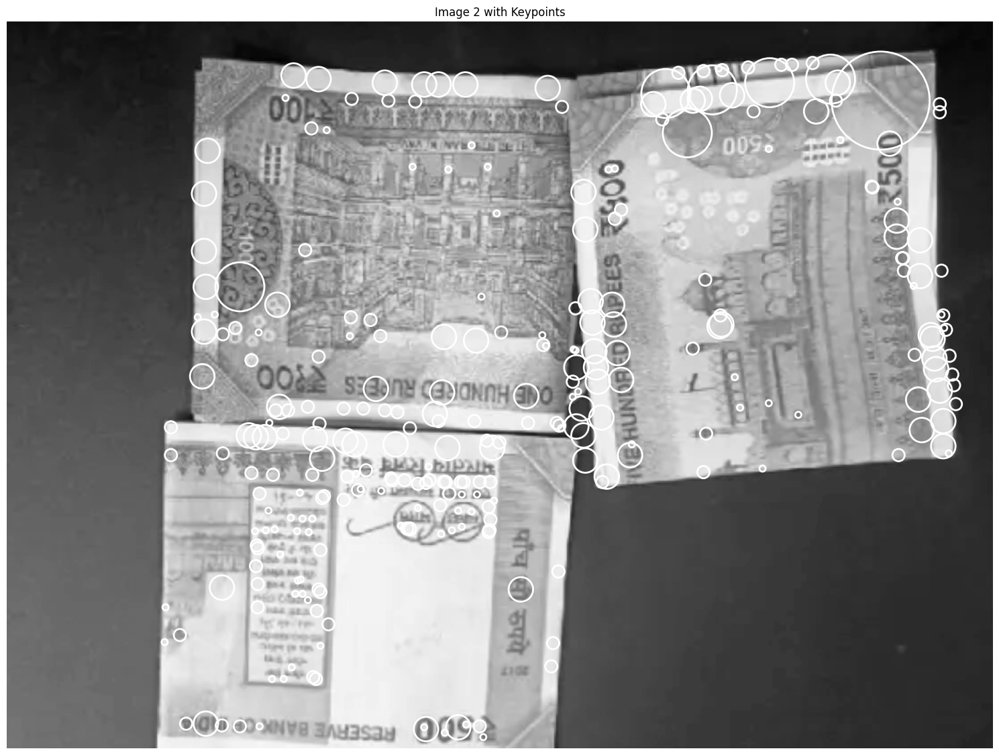

In [166]:
visualize_keypoints(img2, keypoints2, "Image 2 with Keypoints")

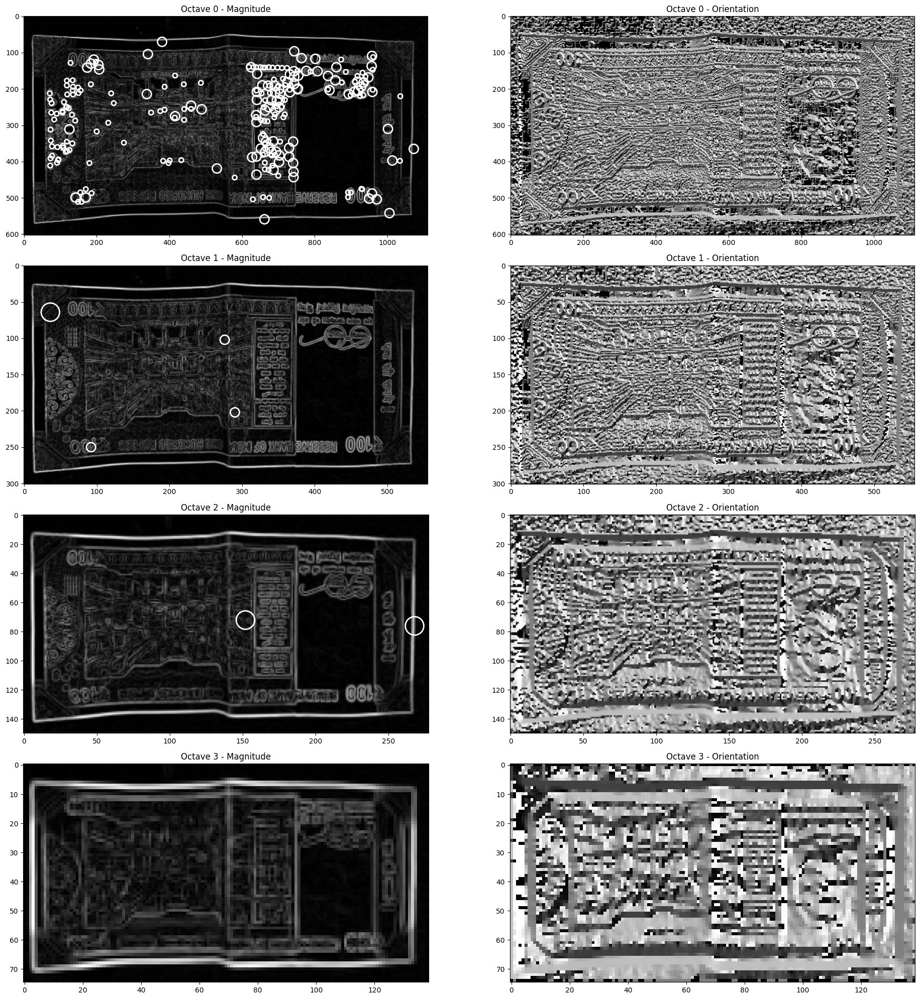

In [167]:
visualize_octaves(gaussian_pyr1, keypoints1, num_octaves1)

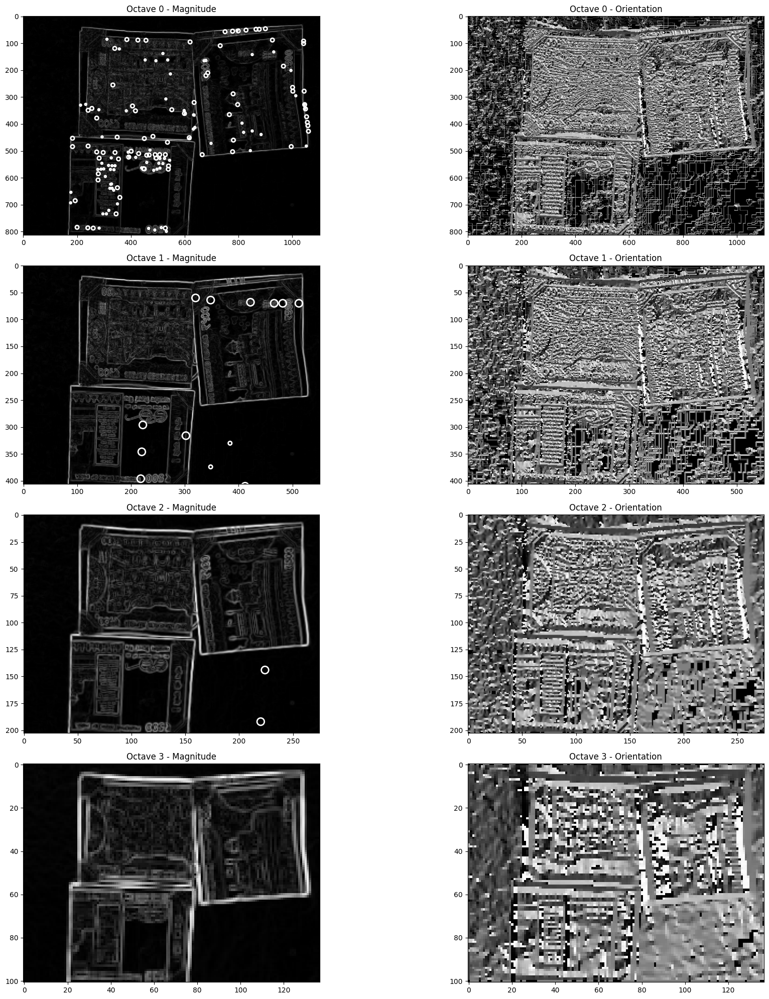

In [168]:
visualize_octaves(gaussian_pyr2, keypoints2, num_octaves2)


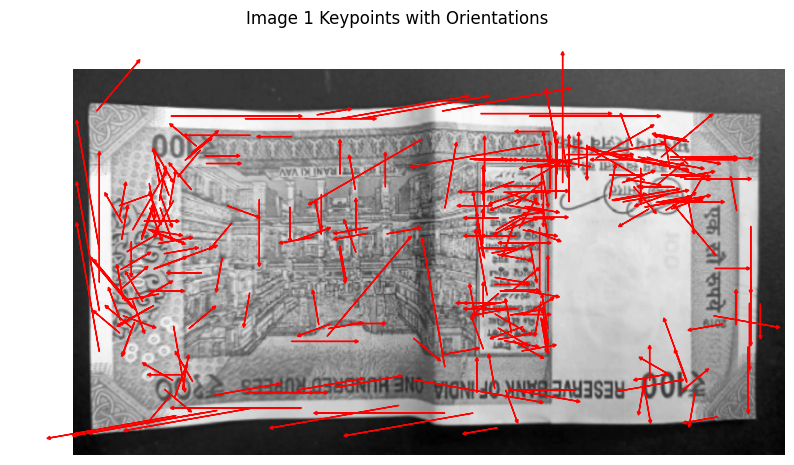

In [169]:
visualize_orientations(img1, orientations1, "Image 1 Keypoints with Orientations")


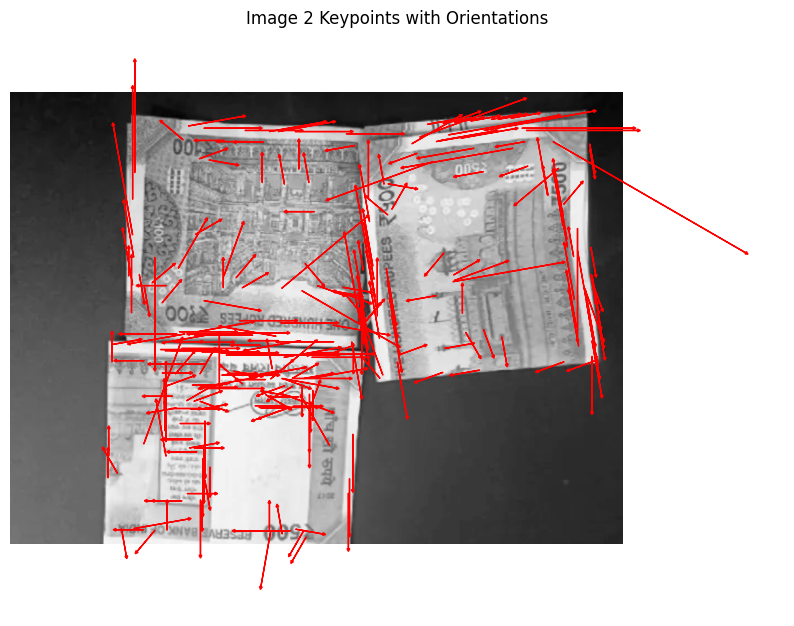

In [170]:
visualize_orientations(img2, orientations2, "Image 2 Keypoints with Orientations")


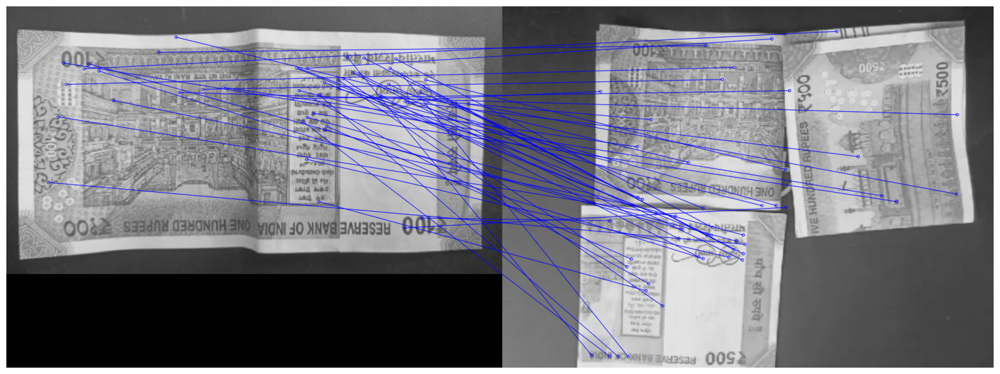

In [171]:
visualize_matches(img1, keypoints1, img2, keypoints2, descriptors1, descriptors2)

# Comparing our results with OpenCV sift function

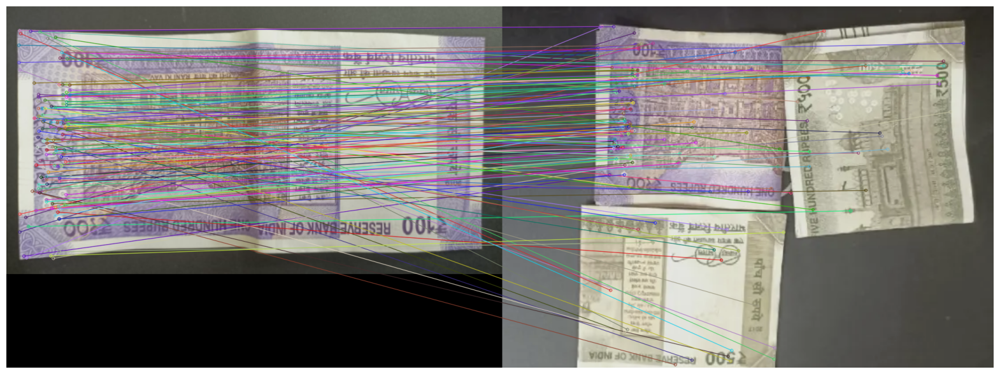

In [172]:
img1 = cv2.imread('./100note.png')  
img2 = cv2.imread('./note_pile.png')

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)  

sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(gray1, None)
kp2, des2 = sift.detectAndCompute(gray2, None)

bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

matches = bf.match(des1, des2)

matched_image = cv2.drawMatches(img1, kp1, img2, kp2, matches[:150], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(20, 15))
plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()


# Example2: Applying SIFT algorithm on DVDs

In [173]:
img1 = cv2.imread('./DVD.jpeg', cv2.IMREAD_GRAYSCALE)  
img2 = cv2.imread('./DVD_pile.jpeg', cv2.IMREAD_GRAYSCALE)  

img1 = img1 / 255.0
img2 = img2 / 255.0

In [174]:
gaussian_pyr1 = gaussian_pyr(img1)
gaussian_pyr2 = gaussian_pyr(img2)

dog_pyr1 = dog_pyr(gaussian_pyr1)
dog_pyr2 = dog_pyr(gaussian_pyr2)

keypoints1 = keypoints(dog_pyr1, threshold=0.03)
keypoints2 = keypoints(dog_pyr2, threshold=0.03)

orientations1 = orientations(keypoints1, gaussian_pyr1)
orientations2 = orientations(keypoints2, gaussian_pyr2)

descriptors1 = descriptors(keypoints1, gaussian_pyr1)
descriptors2 = descriptors(keypoints2, gaussian_pyr2)

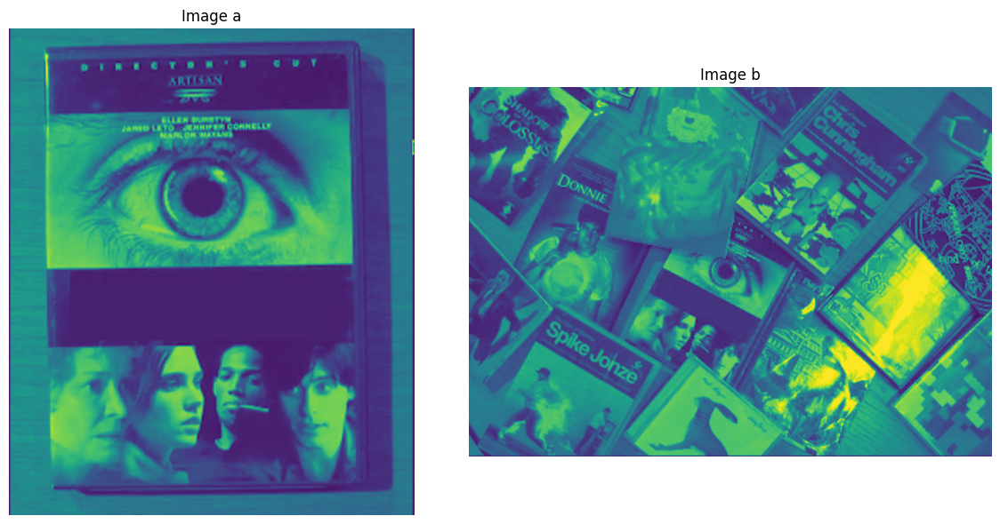

In [175]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.imshow(img1)
ax1.set_title('Image a')
ax1.axis('off')

ax2.imshow(img2)
ax2.set_title('Image b')
ax2.axis('off')
plt.tight_layout()
plt.show()

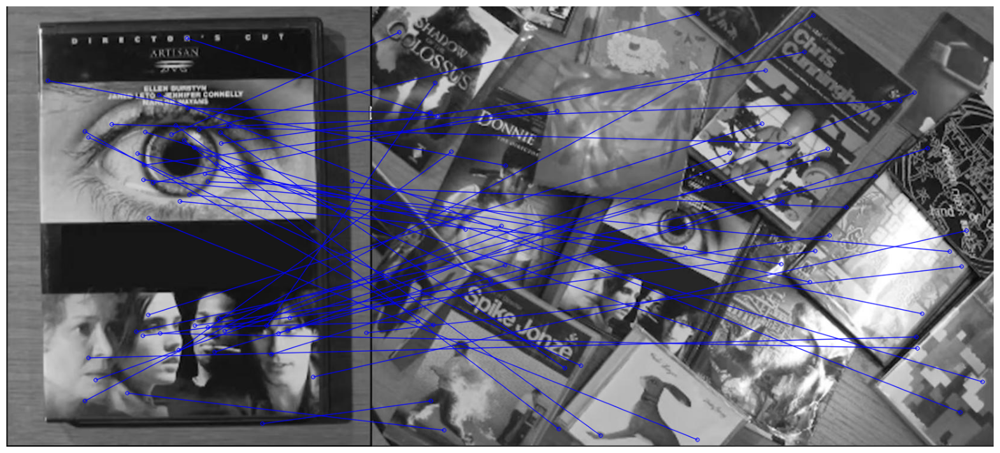

In [176]:
visualize_matches(img1, keypoints1, img2, keypoints2, descriptors1, descriptors2)

# Comparing our results with OpenCV sift function

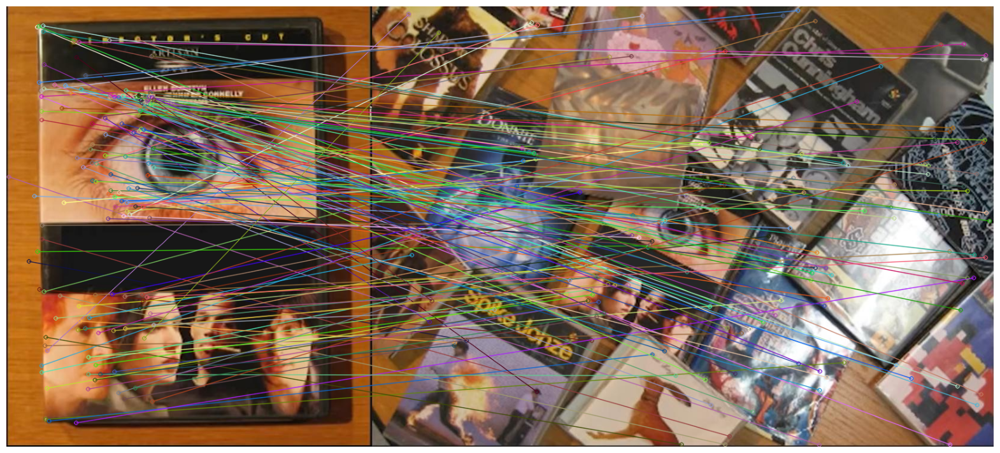

In [177]:
img1 = cv2.imread('./DVD.jpeg')  
img2 = cv2.imread('./DVD_pile.jpeg')

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)  

sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(gray1, None)
kp2, des2 = sift.detectAndCompute(gray2, None)

bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

matches = bf.match(des1, des2)

matched_image = cv2.drawMatches(img1, kp1, img2, kp2, matches[:150], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(20, 15))
plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()